In [1]:
import pandas as pd
import numpy as np
from gurobipy import Model, GRB, quicksum
import matplotlib.pyplot as plt

# 导入并合并数据，将esg缺失值填为0

In [4]:
#确保esg值无缺失
price_df=pd.read_csv('614 price data.csv').set_index('Date')
price_df.index = pd.to_datetime(price_df.index, format='%Y/%m/%d')
esg_df=pd.read_csv('esg13-23.csv').set_index('Date')
esg_df.index = pd.to_datetime(esg_df.index, format='%Y/%m/%d')
esg_df.fillna(0, inplace=True)
esg_df.isnull()

,GM,ATI,LUV,DOW,SLM,CNP,COL,MS,DHR,AES,...,PARA,BALL,ELV,META,CEG,GEHC,RVTY,EG,KVUE,VLTO
Date,,,,,,,,,,,,,,,,,,,,,
2013-01-01,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2013-01-02,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2013-01-03,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2013-01-04,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2013-01-05,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-03-24,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2024-03-25,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2024-03-26,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [7]:
#合并成一个表格：

price_long = price_df.stack().reset_index()
price_long.columns = ['Date', 'Ticker', 'Price']
esg_long = esg_df.stack().reset_index()
esg_long.columns = ['Date', 'Ticker', 'ESG']
# 使用内部合并，确保只合并两个DataFrame都有的股票和日期
combined_df = pd.merge(price_long, esg_long, on=['Date', 'Ticker'], how='left')
# 输出查看结果
combined_df['Daily Return'] = combined_df.groupby('Ticker')['Price'].pct_change()

In [8]:
#删除Daily Return=0的值：

df=combined_df
# Assuming 'df' is your original DataFrame
# Here we are just providing the logic, make sure to replace 'df' with your actual DataFrame

# Create an empty DataFrame to store results
filtered_df = pd.DataFrame()

# Iterate over each unique date
for date in df['Date'].unique():
    # Filter records where 'Daily Return' is not NaN for the current date
    daily_data = df[(df['Date'] == date) & (~df['Daily Return'].isnull())]
    
    # Select only the necessary columns
    daily_data = daily_data[['Date', 'Ticker', 'Daily Return','ESG']]
    
    # Before concatenation, ensure there are no entirely empty or NaN rows
    if not daily_data.empty:
        daily_data.dropna(how='all', inplace=True)
        filtered_df = pd.concat([filtered_df, daily_data], ignore_index=True)
filtered_df.set_index('Date', inplace=True)

,Date,Ticker,Daily Return,ESG
0,2014-01-03,A,0.012631,7.0
1,2014-01-03,AAL,0.046530,0.0
2,2014-01-03,AAP,0.028613,2.0
3,2014-01-03,AAPL,-0.021966,5.0
4,2014-01-03,ABBV,0.006156,3.0
...,...,...,...,...
1486822,2024-03-28,YUM,0.009685,4.0
1486823,2024-03-28,ZBH,-0.004751,6.0
1486824,2024-03-28,ZBRA,0.007621,5.0
1486825,2024-03-28,ZION,0.005794,4.0


In [42]:
# 使用 .loc 方法
goog_df = filtered_df.loc[filtered_df['Ticker'] == 'GOOG']
goog_df['Daily Return'].any()

True

# 写一个函数，算出每个window的mean vector，covariance_matrix和esg_vector（问题：我已经把每个窗口内存在Nan值的都删了，为什么算出来的协方差还有Nan?）

In [13]:
#写一个函数，算出每个window的mean vector，covariance_matrix和esg_vector

def calculate_rolling_metrics(df, window_size):
    rolling_results = []
    start_dates = pd.date_range(start=df.index.min(), 
                                end=df.index.max() - pd.Timedelta(days=window_size), 
                                freq='D')
    
    for start_date in start_dates:
        end_date = start_date + pd.Timedelta(days=window_size - 1)
        window_df = df.loc[start_date:end_date]

        # 移除含有 NaN 的行
        clean_window_df = window_df.dropna()

        # 计算平均日收益率
        expected_returns = clean_window_df.groupby('Ticker')['Daily Return'].mean()

        # 计算协方差矩阵
        covariance_matrix = clean_window_df.pivot(columns='Ticker', values='Daily Return').cov()

        # 提取窗口最后一天的 ESG 评分
        last_day_df = clean_window_df[clean_window_df.index == clean_window_df.index.max()]
        last_day_esg = last_day_df.groupby('Ticker')['ESG'].last()

        # 存储结果
        rolling_results.append({
            'Start_Date': start_date,
            'End_Date': end_date,
            'Expected_Returns': expected_returns,
            'Covariance_Matrix': covariance_matrix,
            'ESG_Scores': last_day_esg
        })

    return pd.DataFrame(rolling_results)


# Set window size to 30 days
WINDOW_SIZE = 30

# Perform rolling window calculation
results_df = calculate_rolling_metrics(filtered_df, WINDOW_SIZE)

In [45]:
results_df

,Start_Date,End_Date,Expected_Returns,Covariance_Matrix,ESG_Scores
0,2014-01-03,2014-02-01,Ticker A 0.001798 AAL 0.014379 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 7.0 AAL 0.0 AAP 2.0 AAP...
1,2014-01-04,2014-02-02,Ticker A 0.001228 AAL 0.012687 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 7.0 AAL 0.0 AAP 2.0 AAP...
2,2014-01-05,2014-02-03,Ticker A -0.000553 AAL 0.012663 AAP ...,Ticker A AAL AAP ...,Ticker A 7.0 AAL 3.0 AAP 2.0 AAP...
3,2014-01-06,2014-02-04,Ticker A 0.000881 AAL 0.012187 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 7.0 AAL 3.0 AAP 2.0 AAP...
4,2014-01-07,2014-02-05,Ticker A 0.000802 AAL 0.010958 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 7.0 AAL 3.0 AAP 2.0 AAP...
...,...,...,...,...,...
3703,2024-02-23,2024-03-23,Ticker A 0.005355 AAL -0.001114 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 6.0 AAL 3.0 AAP 5.0 AAP...
3704,2024-02-24,2024-03-24,Ticker A 0.005618 AAL -0.000809 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 6.0 AAL 3.0 AAP 5.0 AAP...
3705,2024-02-25,2024-03-25,Ticker A 0.004741 AAL -0.000449 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 6.0 AAL 3.0 AAP 5.0 AAP...
3706,2024-02-26,2024-03-26,Ticker A 0.004166 AAL -0.000429 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 6.0 AAL 3.0 AAP 5.0 AAP...


In [40]:
matrix=results_df['Covariance_Matrix'].iloc[509]

In [41]:
# 使用 stack 方法将 DataFrame 转换为 Series，多级索引包括原始的行和列索引
stacked = matrix.stack(dropna=False)  # dropna=False 保留 NaN 值

# 找出是 NaN 的条目
nan_positions = stacked[stacked.isna()]

# 输出 NaN 的位置
print(nan_positions)

Ticker  Ticker
A       WRK      NaN
AAL     WRK      NaN
AAP     WRK      NaN
AAPL    WRK      NaN
ABBV    WRK      NaN
                  ..
YUM     WRK      NaN
ZBH     WRK      NaN
ZBRA    WRK      NaN
ZION    WRK      NaN
ZTS     WRK      NaN
Length: 1125, dtype: float64


/var/folders/th/rxkyh2gs5ks1q73tytpk11lw0000gn/T/ipykernel_9037/1365048204.py:2: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  stacked = matrix.stack(dropna=False)  # dropna=False 保留 NaN 值


In [33]:
#检查'Covariance_Matrix'有没有Nan
with_0=0

for index, row in results_df.iterrows():
    matrix_df = row['Covariance_Matrix']
    # 检查这个 DataFrame 是否含有任何 NaN
    if matrix_df.isna().any().any(): # 第一个 `any()` 检查列，第二个 `any()` 检查结果
        with_0+=1
        print(f"Row {index} contains NaN.")

Row 55 contains NaN.
Row 56 contains NaN.
Row 57 contains NaN.
Row 74 contains NaN.
Row 79 contains NaN.
Row 128 contains NaN.
Row 181 contains NaN.
Row 182 contains NaN.
Row 183 contains NaN.
Row 234 contains NaN.
Row 236 contains NaN.
Row 262 contains NaN.
Row 338 contains NaN.
Row 419 contains NaN.
Row 420 contains NaN.
Row 421 contains NaN.
Row 440 contains NaN.
Row 441 contains NaN.
Row 442 contains NaN.
Row 461 contains NaN.
Row 462 contains NaN.
Row 463 contains NaN.
Row 509 contains NaN.
Row 521 contains NaN.
Row 531 contains NaN.
Row 532 contains NaN.
Row 533 contains NaN.
Row 611 contains NaN.
Row 612 contains NaN.
Row 613 contains NaN.
Row 614 contains NaN.
Row 615 contains NaN.
Row 616 contains NaN.
Row 617 contains NaN.
Row 618 contains NaN.
Row 619 contains NaN.
Row 620 contains NaN.
Row 621 contains NaN.
Row 622 contains NaN.
Row 623 contains NaN.
Row 624 contains NaN.
Row 625 contains NaN.
Row 626 contains NaN.
Row 627 contains NaN.
Row 628 contains NaN.
Row 629 contain

In [19]:
with_0

462

In [47]:
# 现在使用修正后的 filtered_df 来尝试之前的操作 
filtered_df.reset_index(inplace=True)
filtered_df.set_index(['Date','Ticker'], inplace=True)
filtered_df

Daily Return  ESG
Date       Ticker                   
2014-01-03 A           0.012631  7.0
           AAL         0.046530  0.0
           AAP         0.028613  2.0
           AAPL       -0.021966  5.0
           ABBV        0.006156  3.0
...                         ...  ...
2024-03-28 YUM         0.009685  4.0
           ZBH        -0.004751  6.0
           ZBRA        0.007621  5.0
           ZION        0.005794  4.0
           ZTS         0.004154  7.0

[1486827 rows x 2 columns]

# 把用于预测的return也作为一列加进去（对于后一天不交易的股票，我们用前一个月的预测也没什么意义，所以删去）

In [48]:
#把对应需要相乘的下一天股票的return也加到表格里
predicted_returns_dict = {}

# 遍历每个日期和相应的股票返回序列
for end_date, returns_series in zip(results_df['End_Date'], results_df['Expected_Returns']):
    end_date = pd.to_datetime(end_date)  # 确保日期格式正确
    next_day = end_date + pd.Timedelta(days=1)  # 获取下一天
    next_day_str = next_day.strftime('%Y-%m-%d')
    ticker_returns = {}
    for ticker in returns_series.index:
        # 尝试获取每个股票在下一天的 Daily Return
        try:
            daily_return = filtered_df.loc[(next_day, ticker), 'Daily Return']
            ticker_returns[ticker] = daily_return  # 存储股票和对应的回报率
        except KeyError:
            ticker_returns[ticker] = None 
    # 将每天的回报率列表添加到主列表中
    predicted_returns_dict[next_day_str] = ticker_returns

In [49]:
predicted_returns_dict

{'2014-02-02': {'A': None,
  'AAL': None,
  'AAP': None,
  'AAPL': None,
  'ABBV': None,
  'ABMD': None,
  'ABT': None,
  'ACGL': None,
  'ACN': None,
  'ADBE': None,
  'ADI': None,
  'ADM': None,
  'ADP': None,
  'ADSK': None,
  'AEE': None,
  'AEP': None,
  'AES': None,
  'AET': None,
  'AFL': None,
  'AIG': None,
  'AIZ': None,
  'AJG': None,
  'AKAM': None,
  'ALB': None,
  'ALGN': None,
  'ALK': None,
  'ALL': None,
  'ALLE': None,
  'AMAT': None,
  'AMCR': None,
  'AMD': None,
  'AME': None,
  'AMG': None,
  'AMGN': None,
  'AMP': None,
  'AMT': None,
  'AMZN': None,
  'AN': None,
  'ANDV': None,
  'ANSS': None,
  'AON': None,
  'AOS': None,
  'APA': None,
  'APD': None,
  'APH': None,
  'APTV': None,
  'ARE': None,
  'ATI': None,
  'ATO': None,
  'AVB': None,
  'AVGO': None,
  'AVY': None,
  'AWK': None,
  'AXON': None,
  'AXP': None,
  'AYI': None,
  'AZO': None,
  'BA': None,
  'BAC': None,
  'BALL': None,
  'BAX': None,
  'BBWI': None,
  'BBY': None,
  'BDX': None,
  'BEN': N

In [53]:
data = []
for next_day_str, ticker_data in predicted_returns_dict.items():
    # 将字符串日期转换为 datetime 对象
    next_day = pd.to_datetime(next_day_str)
    # 计算 End Date（即日期减一天）
    end_date = next_day - pd.Timedelta(days=1)
    
    # 从 ticker_data 字典中提取所有 daily return 值为列表
    daily_returns = list(ticker_data.values())
    
    # 将提取的数据添加到列表中
    data.append({
        'End_Date': end_date,
        'return_to_pred': daily_returns
    })
df = pd.DataFrame(data)

merged_df = results_df.merge(df, on='End_Date', how='left')
merged_df

,Start_Date,End_Date,Expected_Returns,Covariance_Matrix,ESG_Scores,return_to_pred
0,2014-01-03,2014-02-01,Ticker A 0.001798 AAL 0.014379 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 7.0 AAL 0.0 AAP 2.0 AAP...,"[None, None, None, None, None, None, None, Non..."
1,2014-01-04,2014-02-02,Ticker A 0.001228 AAL 0.012687 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 7.0 AAL 0.0 AAP 2.0 AAP...,"[-0.034393956942565085, 0.01222063390669681, -..."
2,2014-01-05,2014-02-03,Ticker A -0.000553 AAL 0.012663 AAP ...,Ticker A AAL AAP ...,Ticker A 7.0 AAL 3.0 AAP 2.0 AAP...,"[0.02956421163182421, 0.002650169522845136, 0...."
3,2014-01-06,2014-02-04,Ticker A 0.000881 AAL 0.012187 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 7.0 AAL 3.0 AAP 2.0 AAP...,"[-0.006573798985780255, -0.007342084190102294,..."
4,2014-01-07,2014-02-05,Ticker A 0.000802 AAL 0.010958 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 7.0 AAL 3.0 AAP 2.0 AAP...,"[0.014974776195811668, 0.025443755708896676, 0..."
...,...,...,...,...,...,...
3703,2024-02-23,2024-03-23,Ticker A 0.005355 AAL -0.001114 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 6.0 AAL 3.0 AAP 5.0 AAP...,"[None, None, None, None, None, None, None, Non..."
3704,2024-02-24,2024-03-24,Ticker A 0.005618 AAL -0.000809 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 6.0 AAL 3.0 AAP 5.0 AAP...,"[-0.012817899896476748, 0.006747664783520735, ..."
3705,2024-02-25,2024-03-25,Ticker A 0.004741 AAL -0.000449 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 6.0 AAL 3.0 AAP 5.0 AAP...,"[-0.007900480344608107, 0.0, 0.0, -0.006672516..."
3706,2024-02-26,2024-03-26,Ticker A 0.004166 AAL -0.000429 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 6.0 AAL 3.0 AAP 5.0 AAP...,"[0.020497135407247402, 0.02546917613689459, 0...."


In [54]:
#删掉return_to_pred有Nan的行

def is_all_none(lst):
    return all(x is None for x in lst)

# 应用这个函数，并过滤掉那些仅包含 None 的列表
merged_df = merged_df[~merged_df['return_to_pred'].apply(is_all_none)]

# 显示更新后的 DataFrame
merged_df

,Start_Date,End_Date,Expected_Returns,Covariance_Matrix,ESG_Scores,return_to_pred
1,2014-01-04,2014-02-02,Ticker A 0.001228 AAL 0.012687 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 7.0 AAL 0.0 AAP 2.0 AAP...,"[-0.034393956942565085, 0.01222063390669681, -..."
2,2014-01-05,2014-02-03,Ticker A -0.000553 AAL 0.012663 AAP ...,Ticker A AAL AAP ...,Ticker A 7.0 AAL 3.0 AAP 2.0 AAP...,"[0.02956421163182421, 0.002650169522845136, 0...."
3,2014-01-06,2014-02-04,Ticker A 0.000881 AAL 0.012187 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 7.0 AAL 3.0 AAP 2.0 AAP...,"[-0.006573798985780255, -0.007342084190102294,..."
4,2014-01-07,2014-02-05,Ticker A 0.000802 AAL 0.010958 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 7.0 AAL 3.0 AAP 2.0 AAP...,"[0.014974776195811668, 0.025443755708896676, 0..."
5,2014-01-08,2014-02-06,Ticker A 0.000834 AAL 0.012381 AAP ...,Ticker A AAL AAP ...,Ticker A 7.0 AAL 3.0 AAP 2.0 AAP...,"[0.01938600439977023, 0.029140294555091817, 0...."
...,...,...,...,...,...,...
3701,2024-02-21,2024-03-21,Ticker A 0.004797 AAL 0.000474 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 6.0 AAL 3.0 AAP 5.0 AAP...,"[-0.008672909454746525, 0.002706357288952299, ..."
3704,2024-02-24,2024-03-24,Ticker A 0.005618 AAL -0.000809 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 6.0 AAL 3.0 AAP 5.0 AAP...,"[-0.012817899896476748, 0.006747664783520735, ..."
3705,2024-02-25,2024-03-25,Ticker A 0.004741 AAL -0.000449 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 6.0 AAL 3.0 AAP 5.0 AAP...,"[-0.007900480344608107, 0.0, 0.0, -0.006672516..."
3706,2024-02-26,2024-03-26,Ticker A 0.004166 AAL -0.000429 AAP ...,Ticker A AAL AAP AAPL...,Ticker A 6.0 AAL 3.0 AAP 5.0 AAP...,"[0.020497135407247402, 0.02546917613689459, 0...."


# 以第一行为例进行optimization

In [56]:
# 计算预期收益
expected_returns = merged_df['Expected_Returns'].iloc[1]

# 计算协方差矩阵
covariance_matrix = merged_df['Covariance_Matrix'].iloc[1]

# 计算ESG SCORE
ESG_scores=merged_df['ESG_Scores'].iloc[1]

# 计算ESG SCORE
Predicted_return = merged_df['return_to_pred'].iloc[1]

In [57]:
# 假设这些数据已经定义
min_esg_score = 3.5  # 给定的ESG分数

# 目标收益率的范围
target_returns = np.linspace(min(expected_returns), max(expected_returns), num=10)

# 初始化数据收集
risk_data = []
return_data = []
weights_data = []

for target_return in target_returns:
    # 假设 expected_returns 和 ESG_scores 是Pandas Series，covariance_matrix 是Pandas DataFrame
    m = Model("portfolio_optimization")
    weights = m.addVars(len(expected_returns), lb=0, ub=1, name="weights")
    
    # 使用 .iloc 确保按位置访问
    m.addConstr(quicksum(weights[i] * expected_returns.iloc[i] for i in range(len(expected_returns))) >= target_return, "return_target")
    m.addConstr(quicksum(weights[i] * ESG_scores.iloc[i] for i in range(len(expected_returns))) >= min_esg_score, "ESG_constraint")
    m.addConstr(quicksum(weights[i] for i in range(len(expected_returns))) == 1, "sum_of_weights")
    
    # 使用 .iloc 确保访问DataFrame的正确方式
    portfolio_variance = quicksum(weights[i] * covariance_matrix.iloc[i, j] * weights[j] for i in range(len(expected_returns)) for j in range(len(expected_returns)))
    m.setObjective(portfolio_variance, GRB.MINIMIZE)
    
    m.optimize()
        
    if m.status == GRB.OPTIMAL:
        portfolio_std_dev = np.sqrt(portfolio_variance.getValue())
        risk_data.append(portfolio_std_dev)
        return_data.append(target_return)
        # 新增：收集优化后的权重
        optimized_weights = [weights[i].X for i in range(len(expected_returns))]
        weights_data.append(optimized_weights)

Set parameter Username
Academic license - for non-commercial use only - expires 2024-09-12
Gurobi Optimizer version 10.0.3 build v10.0.3rc0 (mac64[arm])

CPU model: Apple M2 Pro
Thread count: 10 physical cores, 10 logical processors, using up to 10 threads

Optimize a model with 3 rows, 548 columns and 1574 nonzeros
Model fingerprint: 0xcd4c37e2
Model has 150426 quadratic objective terms
Coefficient statistics:
  Matrix range     [8e-06, 7e+00]
  Objective range  [0e+00, 0e+00]
  QObjective range [2e-08, 5e-02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [3e-02, 4e+00]
Presolve time: 0.01s
Presolved: 3 rows, 548 columns, 1574 nonzeros
Presolved model has 150426 quadratic objective terms
Ordering time: 0.00s

Barrier statistics:
 Free vars  : 19
 AA' NZ     : 2.310e+02
 Factor NZ  : 2.530e+02
 Factor Ops : 3.795e+03 (less than 1 second per iteration)
 Threads    : 1

                  Objective                Residual
Iter       Primal          Dual         Primal    Dual     C

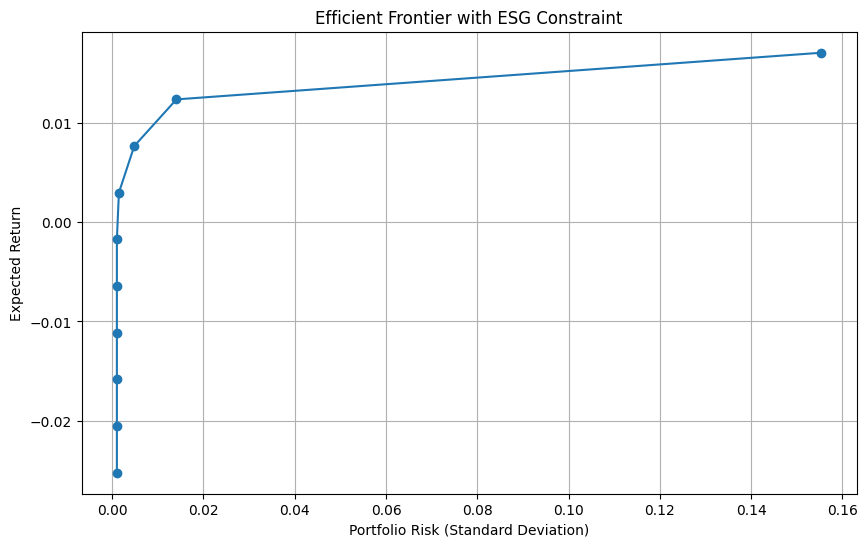

In [58]:
# 绘制Efficient Frontier
plt.figure(figsize=(10, 6))
plt.plot(risk_data, return_data, marker='o')
plt.title("Efficient Frontier with ESG Constraint")
plt.xlabel("Portfolio Risk (Standard Deviation)")
plt.ylabel("Expected Return")
plt.grid(True)
plt.show()

In [59]:
# 假设已经有了以下数据结构和变量定义
portfolio_df = pd.DataFrame({
    'Risk': risk_data,
    'Return': return_data,
    'Weights': weights_data
})
target_risk = 0.02  # 目标风险值

# 找到最接近目标风险的投资组合
closest_portfolio = portfolio_df.iloc[(portfolio_df['Risk'] - target_risk).abs().argsort()[0]]

# 提取对应的权重
weights_at_target_risk = closest_portfolio['Weights']
weights_at_target_risk

[1.0565919166330484e-11,
 0.12377063620168008,
 3.939601476442291e-12,
 8.332878812474407e-12,
 3.5259847368197593e-12,
 4.605315181104953e-12,
 3.965772594885345e-12,
 3.109238717051481e-12,
 3.0794024530998204e-12,
 8.222737586953684e-12,
 5.98809098229173e-12,
 3.719870404510452e-12,
 3.935197251826841e-12,
 1.0971970931907367e-11,
 6.6012720190895895e-12,
 7.122182112289306e-12,
 4.1159658990343784e-12,
 5.383039638932905e-12,
 3.9962997105712055e-12,
 3.741551713749802e-12,
 4.519307041995024e-12,
 4.672960805054873e-12,
 4.8591500202804624e-12,
 5.8033170996301734e-12,
 4.170592063911932e-12,
 1.2937805743890765e-11,
 6.026332553254899e-12,
 4.4881931873261e-12,
 1.0249427856071293e-11,
 4.1236975547723455e-12,
 4.140391864831364e-12,
 3.2869037677098143e-12,
 2.7917779824355723e-12,
 6.4331814185961885e-12,
 3.4998367334959683e-12,
 5.3502601586190244e-12,
 2.5532565387870122e-12,
 3.043717789891327e-12,
 2.6394441779774914e-12,
 4.721903003943355e-12,
 3.5580577767556256e-12,
 

In [60]:
# 使用 zip 将两个列表中的元素配对，然后计算乘积，并求和
weighted_sum = sum(w * r for w, r in zip(weights_at_target_risk, Predicted_return))

print(weighted_sum)

0.0019793742915994303


# 以esg和risk作为输入，在全集上寻找每天的efficient frontier，针对risk值画历史曲线

### 思路一：新建一个以End_Date为索引的表格储存portfolio return

In [75]:
results_df = pd.DataFrame(index=merged_df.index, columns=['Weighted_Sum'])
results_df

,Weighted_Sum
End_Date,
2014-02-02,NaN
2014-02-03,NaN
2014-02-04,NaN
2014-02-05,NaN
2014-02-06,NaN
...,...
2024-03-21,NaN
2024-03-24,NaN
2024-03-25,NaN


In [81]:
def backtester(esg_level, risk_level):
    # 确保有一个用于存储结果的列
    if 'Weighted_Sum' not in results_df.columns:
        results_df['Weighted_Sum'] = np.nan  # 初始化为 NaN

    for index, row in merged_df.iterrows():
        expected_returns = row['Expected_Returns']
        covariance_matrix = row['Covariance_Matrix']
        ESG_scores = row['ESG_Scores']
        Predicted_return = row['return_to_pred']

        target_returns = np.linspace(min(expected_returns), max(expected_returns), num=5)
        portfolio_df = optimize_portfolio(expected_returns, ESG_scores, covariance_matrix, target_returns, esg_level)

        if not portfolio_df.empty:
            closest_portfolio = portfolio_df.iloc[(portfolio_df['Risk'] - risk_level).abs().argsort()[0]]
            weights_at_target_risk = closest_portfolio['Weights']
            weighted_sum = sum(w * r for w, r in zip(weights_at_target_risk, Predicted_return))
        else:
            weighted_sum = 0  # 处理优化不成功的情况

        results_df.at[index, 'Weighted_Sum'] = weighted_sum

In [77]:
def optimize_portfolio(expected_returns, ESG_scores, covariance_matrix, target_returns, min_esg_score):
    risk_data = []
    return_data = []
    weights_data = []

    for target_return in target_returns:
        m = Model("portfolio_optimization")
        weights = m.addVars(len(expected_returns), lb=0, ub=1, name="weights")
        m.addConstr(quicksum(weights[i] * expected_returns.iloc[i] for i in range(len(expected_returns))) >= target_return, "return_target")
        m.addConstr(quicksum(weights[i] * ESG_scores.iloc[i] for i in range(len(expected_returns))) >= min_esg_score, "ESG_constraint")
        m.addConstr(quicksum(weights[i] for i in range(len(expected_returns))) == 1, "sum_of_weights")

        portfolio_variance = quicksum(weights[i] * covariance_matrix.iloc[i, j] * weights[j] for i in range(len(expected_returns)) for j in range(len(expected_returns)))
        m.setObjective(portfolio_variance, GRB.MINIMIZE)
        m.optimize()
        
        if m.status == GRB.OPTIMAL:
            portfolio_std_dev = np.sqrt(portfolio_variance.getValue())
            optimized_weights = [weights[i].X for i in range(len(expected_returns))]
        elif m.status in [GRB.INFEASIBLE, GRB.INF_OR_UNBD]:
            portfolio_std_dev = 0  # 或者设置为 np.nan，根据需要确定
            optimized_weights = [0] * len(expected_returns)  # 设置所有权重为 0
        else:
            continue  # 跳过其他状态，或者做进一步的错误处理

        risk_data.append(portfolio_std_dev)
        return_data.append(target_return)
        weights_data.append(optimized_weights)

    return pd.DataFrame({
        'Risk': risk_data,
        'Return': return_data,
        'Weights': weights_data
    })

In [82]:
# 调用 bactester 函数，假设 merged_df 以及 esg_level 和 risk_level 已经定义
backtester(3, 0.02)

Gurobi Optimizer version 10.0.3 build v10.0.3rc0 (mac64[arm])

CPU model: Apple M2 Pro
Thread count: 10 physical cores, 10 logical processors, using up to 10 threads

Optimize a model with 3 rows, 548 columns and 1569 nonzeros
Model fingerprint: 0xc1a5c331
Model has 150426 quadratic objective terms
Coefficient statistics:
  Matrix range     [2e-05, 7e+00]
  Objective range  [0e+00, 0e+00]
  QObjective range [8e-10, 5e-02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [3e-02, 3e+00]
Presolve time: 0.01s
Presolved: 3 rows, 548 columns, 1569 nonzeros
Presolved model has 150426 quadratic objective terms
Ordering time: 0.00s

Barrier statistics:
 Free vars  : 18
 AA' NZ     : 2.100e+02
 Factor NZ  : 2.310e+02
 Factor Ops : 3.311e+03 (less than 1 second per iteration)
 Threads    : 1

                  Objective                Residual
Iter       Primal          Dual         Primal    Dual     Compl     Time
   0   3.93484045e-13 -3.93484045e-13  5.48e+05 4.71e-07  2.51e+05     0s
   

GurobiError: Element 218 of a double array is Nan or Inf.

In [ ]:
### 思路二：整个循环

In [84]:
def backtester1(ESG_level, risk_level):

    return_list=[]
    
    for i in range(merged_df.shape[0]):
    
        # 计算预期收益
        expected_returns = merged_df['Expected_Returns'].iloc[i]
        
        # 计算协方差矩阵
        covariance_matrix = merged_df['Covariance_Matrix'].iloc[i]
        
        # 计算ESG SCORE
        ESG_scores=merged_df['ESG_Scores'].iloc[i]
        
        # 计算ESG SCORE
        Predicted_return = merged_df['return_to_pred'].iloc[i]
        
        # 假设这些数据已经定义
        min_esg_score = ESG_level  # 给定的ESG分数
        
        # 目标收益率的范围
        target_returns = np.linspace(min(expected_returns), max(expected_returns), num=5)
    
        # 初始化数据收集
        risk_data = []
        return_data = []
        weights_data = []
        
        for target_return in target_returns:
            # 假设 expected_returns 和 ESG_scores 是Pandas Series，covariance_matrix 是Pandas DataFrame
            m = Model("portfolio_optimization")
            weights = m.addVars(len(expected_returns), lb=0, ub=1, name="weights")
            
            # 使用 .iloc 确保按位置访问
            m.addConstr(quicksum(weights[i] * expected_returns.iloc[i] for i in range(len(expected_returns))) >= target_return, "return_target")
            m.addConstr(quicksum(weights[i] * ESG_scores.iloc[i] for i in range(len(expected_returns))) >= min_esg_score, "ESG_constraint")
            m.addConstr(quicksum(weights[i] for i in range(len(expected_returns))) == 1, "sum_of_weights")
            
            # 使用 .iloc 确保访问DataFrame的正确方式
            portfolio_variance = quicksum(weights[i] * covariance_matrix.iloc[i, j] * weights[j] for i in range(len(expected_returns)) for j in range(len(expected_returns)))
            m.setObjective(portfolio_variance, GRB.MINIMIZE)
            
            m.optimize()
            
            if m.status == GRB.OPTIMAL:
                portfolio_std_dev = np.sqrt(portfolio_variance.getValue())
                risk_data.append(portfolio_std_dev)
                return_data.append(target_return)
                # 新增：收集优化后的权重
                optimized_weights = [weights[i].X for i in range(len(expected_returns))]
                weights_data.append(optimized_weights)

        # 假设已经有了以下数据结构和变量定义
        portfolio_df = pd.DataFrame({
            'Risk': risk_data,
            'Return': return_data,
            'Weights': weights_data
        })
        target_risk = risk_level  # 目标风险值
        
        # 找到最接近目标风险的投资组合
        closest_portfolio = portfolio_df.iloc[(portfolio_df['Risk'] - target_risk).abs().argsort()[0]]
        
        # 提取对应的权重
        weights_at_target_risk = closest_portfolio['Weights']
        weighted_sum = sum(w * r for w, r in zip(weights_at_target_risk, Predicted_return))
        
        return_list.append(weighted_sum)

    return return_list

In [85]:
result=backtester1(3, 0.02)

Gurobi Optimizer version 10.0.3 build v10.0.3rc0 (mac64[arm])

CPU model: Apple M2 Pro
Thread count: 10 physical cores, 10 logical processors, using up to 10 threads

Optimize a model with 3 rows, 548 columns and 1569 nonzeros
Model fingerprint: 0xc1a5c331
Model has 150426 quadratic objective terms
Coefficient statistics:
  Matrix range     [2e-05, 7e+00]
  Objective range  [0e+00, 0e+00]
  QObjective range [8e-10, 5e-02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [3e-02, 3e+00]
Presolve time: 0.01s
Presolved: 3 rows, 548 columns, 1569 nonzeros
Presolved model has 150426 quadratic objective terms
Ordering time: 0.00s

Barrier statistics:
 Free vars  : 18
 AA' NZ     : 2.100e+02
 Factor NZ  : 2.310e+02
 Factor Ops : 3.311e+03 (less than 1 second per iteration)
 Threads    : 1

                  Objective                Residual
Iter       Primal          Dual         Primal    Dual     Compl     Time
   0   3.93484045e-13 -3.93484045e-13  5.48e+05 4.71e-07  2.51e+05     0s
   

GurobiError: Element 218 of a double array is Nan or Inf.

In [98]:
matrix=merged_df['Covariance_Matrix'].iloc[218]
list=[]
for i in range(557):
    for j in range(557):
        if matrix.iloc[i, j]is 'Nan':
           list.append((i,j))

<>:5: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:5: SyntaxWarning: "is" with a literal. Did you mean "=="?
/var/folders/th/rxkyh2gs5ks1q73tytpk11lw0000gn/T/ipykernel_9037/1445211510.py:5: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if matrix.iloc[i, j]is 'Nan':


[]